# DaseAlgo Lab1: LSH
In order to finish the lab with many pre-built tools and test the missrate and times, I choose python first to get the results.
As can been seen in the code, numpy module is **Only** used to build a faster-acccess c-style array, and not for math tools.

In [25]:
import numpy as np

- Config and Params

In [149]:
TEST_FILE = "../test.txt"
INPUT_FILE = "../input.txt"
SIGNATURE_FILE = "../signature.txt"

kMaxHashNumber = 18771

kNumOfHashes = 96

kNodeNumber = 18771

# kBands = 32
# kRowsOfBand = int(kNumOfHashes / kBands)
kRowsOfBand = 4
kNumBuckets = 4096

kProbes = 4
kPertube = 1

- Timeit decoraters

Utils to measure the run time of a step, not for timetesting in the report.

In [118]:
import time

def timeit(func):
    def wrapper(*args, **kwargs):
        start = time.time()
        result = func(*args, **kwargs)
        end = time.time()
        print(f"{func.__name__} executed {end - start} seconds")
        return result
    return wrapper

- The hash function module

Attention: the hash function must be a permutation hash \floor{(ax + b) / w} inorder to keep locality sensitive and near the target bucket (multi-probe lsh)

In [119]:
# The input of hash function should be range from 1 to n
# The output of hash will be range from 0 to m - 1
class PermHash:
    def __init__(self, n, m):
        self.max_number = n
        self.mod_number = m
        # self.offset = np.random.randint(1, n)
        self.rand_permutation = np.random.permutation(n)
    
    def get(self, input):
        mapped_input = input % self.max_number + 1
        return self.rand_permutation[mapped_input - 1] % self.mod_number
        # return (input + self.offset) % self.mod_number


## Checkpoint 0: The basic lsh engine 

Write the basic lsh engine based on what we learned in the class

In [129]:
class LshEngine:
    def __init__(self, numHashes, numNodes, inputFile, rowOfBand):
        self.numHashes = numHashes
        self.numNodes = numNodes
        self.inputFile = inputFile
                
        self.rowOfBand = rowOfBand
        self.numBands = int(numHashes / self.rowOfBand)


        # Inner container for the function
        self.minHashSignature = np.zeros((numNodes, numHashes), dtype=int)
        self.bucketDict = []
        for i in range(kNumBuckets):
            self.bucketDict.append(set())


        self.permHashes = []
        for i in range(numHashes):
            tempHash = PermHash(kNodeNumber, kMaxHashNumber)
            self.permHashes.append(tempHash)
        
        self.bucketHash = PermHash(kMaxHashNumber * self.rowOfBand, kNumBuckets)

    def jaccard(self, line1, line2):
        intersection = 0
        union = 0
        
        for i in range(self.numHashes):
            if self.minHashSignature[line1 - 1][i] == self.minHashSignature[line2 - 1][i]:
                intersection += 1
                union += 1
            else:
                union += 2
        
        similarity = intersection / union
        return similarity
    
    @timeit
    def minHash(self):
        # TODO: handle the input file
        minhash = []
        # minhash.reshape(1, self.numHashes)
        for i in range(self.numHashes):
            minhash.append(1 << 31)

        with open(self.inputFile, "r") as f:
            cnt = 0

            for line in f:
                if line.startswith("%"):
                    continue
                temp = line.strip().split()

                if int(temp[0]) > cnt:
                    assert(int(temp[0]) == cnt + 1)
                    # put the previous result of min hash of a line into the signature matrix
                    # print(f"Cnt: {cnt}")
                    if cnt != 0:
                        # print(f"Writing line {cnt - 1} to signature matrix...")
                        # print(f"MinHash line {cnt - 1}: {minhash}")
                        for i in range(self.numHashes):
                            self.minHashSignature[cnt - 1][i] = minhash[i]
                            minhash[i] = 1 << 31
                        
                    cnt = cnt + 1

                entry = int(temp[1])
                for i in range(self.numHashes):
                    result = self.permHashes[i].get(entry)
                    # judge after permutation, whether the result is the minimum value
                    if result < minhash[i]:
                        minhash[i] = result
            # The last line of has result has not been saved into the signature matrix, handle it manually
            for i in range(self.numHashes):
                self.minHashSignature[cnt - 1][i] = minhash[i]
            # after that, we should have finished the calculation of the whole signature matrix
    
    @timeit
    def lsh(self):
        # process signature matrix row by row
        for i in range(self.numNodes):
            row = self.minHashSignature[i]

            # divide the row into bands and hash each band to a bucket
            for bandIndex in range(self.numBands):
                bandStartIndex = bandIndex * self.rowOfBand
                bandEndIndex = (bandIndex + 1) * self.rowOfBand

                # calculate the hash value of the band and use it as the bucket key
                # Here, I use the sum of all r in one band
                sum = 0
                for ent in range(bandStartIndex, bandEndIndex):
                    sum += self.minHashSignature[i][ent]
                bandHash = self.bucketHash.get(sum)
                bucketIndex = bandHash % kNumBuckets  # use both the band hash and row index to determine the bucket index

                # add the current node to the bucket
                self.bucketDict[bucketIndex].add(i)
        
    def printBucket(self):
        print("---------------LSH RESULT------------------")
        for i in range(kNumBuckets):
            print(len(self.bucketDict[i]), end=", ")
        print()
            
    # @timeit
    def candidate(self, targetLine):
        # now we have built the bucketDict, let's find candidate pairs
        targetBucketIndices = set()
        for bandIndex in range(self.numBands):
            bandStartIndex = bandIndex * self.rowOfBand
            bandEndIndex = (bandIndex + 1) * self.rowOfBand

            # calculate the hash value of the band and use it as the bucket key
            # Here, I use the sum of all r in one band
            sum = 0
            for ent in range(bandStartIndex, bandEndIndex):
                sum += self.minHashSignature[targetLine][ent]
            bandHash = self.bucketHash.get(sum)
            bucketIndex = bandHash % kNumBuckets
            targetBucketIndices.add(bucketIndex)

        candidate = set()
        # print(f"Indices: {targetBucketIndices}")

        setCnt = 0
        for bucketIndex in targetBucketIndices:
            bucket = self.bucketDict[bucketIndex]

            if len(bucket) >= 2:
                setCnt += 1
                
                # we have at least 2 nodes in this bucket, let's check all pairs of nodes in this bucket
                for node in bucket:
                    if node == targetLine:
                        continue
                    candidate.add(node)

        return candidate

In [108]:
testEngine = LshEngine(kNumOfHashes, kNodeNumber, INPUT_FILE)
testEngine.minHash()
testEngine.lsh()

minHash executed 75.87550520896912 seconds
lsh: line: 0 -- bucketIndex: 286
lsh: line: 0 -- bucketIndex: 766
lsh: line: 0 -- bucketIndex: 920
lsh: line: 0 -- bucketIndex: 179
lsh: line: 0 -- bucketIndex: 374
lsh: line: 0 -- bucketIndex: 1069
lsh: line: 0 -- bucketIndex: 812
lsh: line: 0 -- bucketIndex: 106
lsh: line: 0 -- bucketIndex: 1988
lsh: line: 0 -- bucketIndex: 580
lsh: line: 0 -- bucketIndex: 165
lsh: line: 0 -- bucketIndex: 787
lsh: line: 0 -- bucketIndex: 362
lsh: line: 0 -- bucketIndex: 2044
lsh: line: 0 -- bucketIndex: 1661
lsh: line: 0 -- bucketIndex: 1804
lsh: line: 1 -- bucketIndex: 415
lsh: line: 1 -- bucketIndex: 1914
lsh: line: 1 -- bucketIndex: 255
lsh: line: 1 -- bucketIndex: 1227
lsh: line: 1 -- bucketIndex: 112
lsh: line: 1 -- bucketIndex: 1122
lsh: line: 1 -- bucketIndex: 1441
lsh: line: 1 -- bucketIndex: 891
lsh: line: 1 -- bucketIndex: 1565
lsh: line: 1 -- bucketIndex: 1727
lsh: line: 1 -- bucketIndex: 290
lsh: line: 1 -- bucketIndex: 2017
lsh: line: 1 -- bucke

In [78]:
testNode = 1
candidate = testEngine.candidate(testNode)

res = []
for each in candidate:
    tempJacc = testEngine.jaccard(testNode, each)
    res.append((tempJacc, each))

res.sort(reverse=True)
print("Top Nodes: ", end="")

for i in range(10):
    print(res[:10][i])

Top Nodes: (0.1352549889135255, 17)
(0.07676130389064142, 40)
(0.07001044932079414, 47)
(0.06334371754932502, 75)
(0.06334371754932502, 45)
(0.05785123966942149, 63)
(0.053497942386831275, 44)
(0.04383282364933741, 54)
(0.04276985743380855, 56)
(0.04065040650406504, 6432)


## Checkpoint 1: Real jaccard similarity
Now we finished the basic LSH to estimate Jaccard similarity, then we need to store the whole adjacent matrix to calculate the real ranking of Jaccard similarity

In [32]:
class AuthorGraph:
    def __init__(self, numNodes, inputFile):
        self.numNodes = numNodes
        self.inputFile = inputFile

        self.simMatrix = [] # Record the calculated Jaccard similarity of node pairs
        self.adjacent = [] # Record the adjacent matrix of the whole graph
        for i in range(numNodes):
            self.simMatrix.append([])
            self.adjacent.append([])
        assert(len(self.simMatrix) == numNodes)
    
    # @timeit
    def getAdj(self):
        with open(self.inputFile, "r") as f:
            cnt = 0
            tempAdj = []
            for line in f:
                if line.startswith("%"):
                    print("Reading the head infomation of the input file")
                    continue
                temp = line.strip().split()

                if int(temp[0]) > cnt:
                    assert(int(temp[0]) == cnt + 1)
                    if cnt != 0:
                        for i in tempAdj:
                            self.adjacent[cnt - 1].append(i)
                        tempAdj = []
                    cnt = cnt + 1

                tempAdj.append(int(temp[1]))
                
            # The last line of has result has not been saved into the adjacent matrix, handle it manually
            for i in tempAdj:
                self.adjacent[cnt - 1].append(i)
            tempAdj = []
            # after that, we should have finished the calculation of the whole signature matrix
            assert(len(self.adjacent) == self.numNodes)

    def jaccard(self, line1, line2):
        set1 = set(self.adjacent[line1 - 1])
        set2 = set(self.adjacent[line2 - 1])

        intersection = len(set1.intersection(set2))
        union = len(self.adjacent[line1 - 1]) + len(self.adjacent[line2 - 1]) - intersection

        return intersection / union if union != 0 else 0
    
    # Get the full ranking result of the whole result
    @timeit
    def ranking(self):
        """
        For each line, we have the adjacent list (First loop)
            For each adjacent list, we have connected nodes (Second loop)
                If node < line, then we just find the result from the self.simMatrix[line]
                Else, calculate the jaccard similarity and append to the list
            After calculation, sort and get the rankings
        """
        cnt = 1
        for each_line in self.adjacent:
            for node in each_line:
                if node < cnt:
                    for res in self.simMatrix[node - 1]:
                        if res[1] == cnt:
                            self.simMatrix[cnt - 1].append((res[0], node))
                            break
                else:
                    self.simMatrix[cnt - 1].append((self.jaccard(cnt, node), node))
            (self.simMatrix[cnt - 1]).sort(reverse=True)
            cnt += 1
    
    def printSim(self):
        cnt = 1
        for each_line in self.simMatrix:
            print(f"------------Ranking of line {cnt}------------")
            r = 20 if 20 < len(each_line) else len(each_line)
            for i in range(r):
                print(each_line[i])
            cnt += 1

    def getTop10(self):
        ret = []
        for i in range(kNodeNumber):
            temp = []
            if len(self.simMatrix[i]) < 20:
                ret.append(temp)
                continue
            for j in range(10):
                temp.append(self.simMatrix[i][j][1])
            ret.append(temp)
        return ret


    def getTop20(self):
        ret = []
        for i in range(kNodeNumber):
            temp = []
            if len(self.simMatrix[i]) < 20:
                ret.append(temp)
                continue
            for j in range(10):
                temp.append(self.simMatrix[i][j + 10][1])
            ret.append(temp)
        return ret


As we can see from the result, with big params (lots of hash function, lots of bands), the basic lsh has a very decent rate of **Recall rate** about 85%

In [53]:
def test():
    graph = AuthorGraph(kNodeNumber, INPUT_FILE)
    graph.getAdj()
    graph.ranking()
    # node2test = []
    # for i in range(kNodeNumber):
    #     if (len(graph.adjacent[i]) > 40):
    #         node2test.append(i + 1)
    # print(node2test[::20])
    graph.printSim()

test()

Reading the head infomation of the input file
ranking executed 1.1347668170928955 seconds
------------Ranking of line 1------------
(0.23333333333333334, 17)
(0.14130434782608695, 40)
(0.12790697674418605, 63)
(0.11956521739130435, 75)
(0.11711711711711711, 47)
(0.0967741935483871, 45)
(0.09411764705882353, 56)
(0.07964601769911504, 44)
(0.07894736842105263, 42)
(0.07874015748031496, 41)
(0.07407407407407407, 19)
(0.07142857142857142, 73)
(0.07086614173228346, 61)
(0.0707070707070707, 2)
(0.07042253521126761, 16)
(0.06593406593406594, 29)
(0.0641025641025641, 28)
(0.06329113924050633, 60)
(0.0625, 62)
(0.061855670103092786, 11)
------------Ranking of line 2------------
(0.2647058823529412, 32)
(0.20408163265306123, 11)
(0.19607843137254902, 40)
(0.12121212121212122, 34)
(0.1111111111111111, 3308)
(0.10869565217391304, 3316)
(0.09375, 3324)
(0.09375, 3306)
(0.08888888888888889, 3315)
(0.08333333333333333, 3320)
(0.07894736842105263, 3323)
(0.07894736842105263, 3317)
(0.07272727272727272

## Checkpoint 2: Improvement (Multi-probe LSH)

Paying attention to the time cost, we can see that the most time-costly step is **calculating the minHash signature**.
However, if I reduce the number of hash function, it performs poorly at basic lsh.
According to the paper, we can implement the multi-probe lsh to reduce the number of hash function with good recall rate.

- New params:
  - Number of probes
  - pertube area (also known as $\Delta$)

In [155]:
class MultiProbeLshEngine:
    def __init__(self, numHashes, numNodes, inputFile, rowOfBand):
        self.numHashes = numHashes
        self.numNodes = numNodes
        self.inputFile = inputFile

        self.rowOfBand = rowOfBand
        self.numBands = int(numHashes / rowOfBand)

        # Inner container for the function
        self.minHashSignature = np.zeros((numNodes, numHashes), dtype=int)
        self.bucketTable = []
        for j in range(kProbes):
            bucketDict = []
            for i in range(kNumBuckets):
                bucketDict.append(set())
            self.bucketTable.append(bucketDict)


        self.permHashes = []
        for i in range(numHashes):
            tempHash = PermHash(kNodeNumber, kMaxHashNumber)
            self.permHashes.append(tempHash)
        
        # init the k probe hash buckets
        self.bucketHashes = []
        for i in range(kProbes):
            bucketHash = PermHash(kMaxHashNumber * self.rowOfBand, kNumBuckets)
            self.bucketHashes.append(bucketHash)

    def jaccard(self, line1, line2):
        intersection = 0
        union = 0
        
        for i in range(self.numHashes):
            if self.minHashSignature[line1 - 1][i] == self.minHashSignature[line2 - 1][i]:
                intersection += 1
                union += 1
            else:
                union += 2
        
        similarity = intersection / union
        return similarity
    
    @timeit
    def minHash(self):
        # TODO: handle the input file
        minhash = []
        # minhash.reshape(1, self.numHashes)
        for i in range(self.numHashes):
            minhash.append(1 << 31)

        with open(self.inputFile, "r") as f:
            cnt = 0

            for line in f:
                if line.startswith("%"):
                    continue
                temp = line.strip().split()

                if int(temp[0]) > cnt:
                    assert(int(temp[0]) == cnt + 1)
                    # put the previous result of min hash of a line into the signature matrix
                    # print(f"Cnt: {cnt}")
                    if cnt != 0:
                        # print(f"MinHash line {cnt - 1}: {minhash}")
                        for i in range(self.numHashes):
                            self.minHashSignature[cnt - 1][i] = minhash[i]
                            minhash[i] = 1 << 31
                        
                    cnt = cnt + 1

                entry = int(temp[1])
                for i in range(self.numHashes):
                    result = self.permHashes[i].get(entry)
                    # judge after permutation, whether the result is the minimum value
                    if result < minhash[i]:
                        minhash[i] = result
            # The last line of has result has not been saved into the signature matrix, handle it manually
            for i in range(self.numHashes):
                self.minHashSignature[cnt - 1][i] = minhash[i]
            # after that, we should have finished the calculation of the whole signature matrix
    
    @timeit
    def multiProbeLsh(self):
        # process signature matrix row by row
        for i in range(self.numNodes):
            row = self.minHashSignature[i]

            # divide the row into bands and hash each band to a bucket
            for bandIndex in range(self.numBands):
                bandStartIndex = bandIndex * self.rowOfBand
                bandEndIndex = (bandIndex + 1) * self.rowOfBand

                # calculate the hash value of the band and use it as the bucket key
                # Here, I use the sum of all r in one band
                sum = 0
                for ent in range(bandStartIndex, bandEndIndex):
                    sum += self.minHashSignature[i][ent]
                
                for j in range(kProbes):
                    bandHash = (self.bucketHashes[j]).get(sum)
                    bucketIndex = bandHash % kNumBuckets  # use both the band hash and row index to determine the bucket index
                    # add the current node to the bucket
                    self.bucketTable[j][bucketIndex].add(i)

    def printBucket(self):
        print("---------------LSH RESULT------------------")
        for j in range(kProbes):
            print(f"###############Probe {j + 1}################")
            for i in range(kNumBuckets):
                print(len(self.bucketTable[j][i]), end=", ")
        print()
            
    def candidate(self, targetLine):
        # now we have built the bucketDict, let's find candidate pairs
        targetBucketIndices = []
        for i in range(kProbes):
            targetBucketIndices.append(set())
        for bandIndex in range(self.numBands):
            bandStartIndex = bandIndex * self.rowOfBand
            bandEndIndex = (bandIndex + 1) * self.rowOfBand

            # calculate the hash value of the band and use it as the bucket key
            # Here, I use the sum of all r in one band
            sum = 0
            for ent in range(bandStartIndex, bandEndIndex):
                sum += self.minHashSignature[targetLine][ent]
            for j in range(kProbes):
                bandHash = (self.bucketHashes[j]).get(sum)
                bucketIndex = bandHash % kNumBuckets
                targetBucketIndices[j].add(bucketIndex)

        candidate = set()

        for j in range(kProbes):
            line = self.bucketTable[j]
            for target_idx in targetBucketIndices[j]:
                # Now we need to probe the range of each_idx based on the pertube value
                start = target_idx - kPertube
                end = target_idx + kPertube
                if start < 0:
                    start = 0
                    end = start + 2 * kPertube
                elif end >= kNumBuckets:
                    end = kNumBuckets - 2
                    start = end - 2 * kPertube
                
                rangeList = [p for p in range(start, end)]
                for each_idx in rangeList:
                    bucket = line[each_idx]
                    if len(bucket) >= 2:
                        # we have at least 2 nodes in this bucket, let's check all pairs of nodes in this bucket
                        for node in bucket:
                            if node == targetLine:
                                continue
                            candidate.add(node)
                            
        return candidate

In [151]:
mpEngine = MultiProbeLshEngine(kNumOfHashes, kNodeNumber, INPUT_FILE, kRowsOfBand)
mpEngine.minHash()
mpEngine.multiProbeLsh()

minHash executed 22.570217847824097 seconds
multiProbeLsh executed 3.720010995864868 seconds


In [152]:
testNode = 1
candidate = mpEngine.candidate(testNode)

print(f"Length of candidate: {len(candidate)}")
res = []
for each in candidate:
    tempJacc = mpEngine.jaccard(testNode, each)
    res.append((tempJacc, each))

res.sort(reverse=True)
print("Top Nodes: ", end="")

for i in range(10):
    print(res[:10][i])

Length of candidate: 15443
Top Nodes: (0.12941176470588237, 17)
(0.09090909090909091, 40)
(0.0847457627118644, 47)
(0.07865168539325842, 41)
(0.07262569832402235, 45)
(0.06077348066298342, 61)
(0.054945054945054944, 42)
(0.054945054945054944, 16)
(0.04918032786885246, 6432)
(0.04918032786885246, 5161)


## Checkpoint 3: Evaluation of algorithm

For an lsh algorithm, we need to evaluate the accuracy, time cost and space cost

- Time cost and space cost

It is not very important to evaluate these costs, because we can calculate it directly

The only cost we need to pay attention is calculating the minhash signature (which is the most costly actually), in this 

lab it is $\Theta(kn)$, for both time and space

And the lsh cost is sublinear, it only depends on the bands, for multi-probe lsh, it will times the probe number

Candidate cost is similar, for multi-probe lsh, it will times probes and range of pertubes

In [156]:
def recall(lshRanking: list, 
           top10Ranking: list, 
           otherRanking: list, length = 10) -> float:

    try:
        assert(len(otherRanking) == length)

        sum = 0
        for i in range(length):
            node = lshRanking[i]
            if node in top10Ranking:
                sum += 1
            elif node in otherRanking[:5]:
                sum += 1
            elif node in otherRanking[5:]:
                sum += 0.7
        
        sum /= 10
        return sum
    except(AssertionError):
        print(f"Error: {len(otherRanking)} != 10")
    

# real result of jaccard similarity ranking
realGraph = AuthorGraph(kNodeNumber, INPUT_FILE)
realGraph.getAdj()
realGraph.ranking()

top10 = realGraph.getTop10()
top20 = realGraph.getTop20()

# print(top20)

node2test = []
for i in range(kNodeNumber):
    if (len(top10[i]) == 10 and len(top20[i]) == 10):
        node2test.append(i + 1)
testNode = node2test[::100]
print(f"Node to be tested: {len(testNode)}")
# test 1
def recallRateTest():
    # testNode = [i * 100 + 21 for i in range(50)]
    testNumHashes = [i * 32 for i in range(1, 10)]
    # testNumHashes = [512]

    ret = [[], []]
    for i in testNumHashes:
        print(f"Testing hash number {i} recall rate...")
        testEngine = LshEngine(i, kNodeNumber, INPUT_FILE, kRowsOfBand)
        testEngine.minHash()
        testEngine.lsh()

        mpEngine = MultiProbeLshEngine(i, kNodeNumber, INPUT_FILE, kRowsOfBand)
        mpEngine.minHash()
        mpEngine.multiProbeLsh()

############################
# Measuring acc for both basic lsh and multi probe lsh
############################

    # basic lsh acc
        sum = 0
        cnt = 0
        for each_node in testNode:
            if (len(realGraph.simMatrix[each_node]) < 20):
                continue

            # calculate the lsh result
            cnt += 1
            res = []
            candidate = testEngine.candidate(each_node)
            for each in candidate:
                tempJacc = testEngine.jaccard(each_node, each)
                res.append((tempJacc, each))

            res.sort(reverse=True)

            lshResult = []
            # prepare the lsh result
            for j in range(10):
                lshResult.append(res[:10][j][1])
            
            acc = recall(lshResult, top10[each_node - 1], top20[each_node - 1])
            print(f"Recall rate: {acc}, Candidates: {len(candidate)} with node {each_node}")
            sum += acc

    # multi-probe lsh acc
        msum = 0
        mcnt = 0
        for each_node in testNode:
            if (len(realGraph.simMatrix[each_node]) < 20):
                continue

            # calculate the lsh result
            mcnt += 1
            res = []
            candidate = mpEngine.candidate(each_node)
            for each in candidate:
                tempJacc = testEngine.jaccard(each_node, each)
                res.append((tempJacc, each))

            res.sort(reverse=True)

            lshResult = []
            # prepare the lsh result
            for j in range(10):
                lshResult.append(res[:10][j][1])
            
            acc = recall(lshResult, top10[each_node - 1], top20[each_node - 1])
            print(f"Recall rate: {acc}, Candidates: {len(candidate)} with node {each_node}")
            msum += acc
        
        print(f"Tested node number: {cnt}")
        rate1 = sum / cnt
        rate2 = msum / mcnt
        print(f"Recall rate: {rate1} with {i} hash functions (Basic lsh)")
        print(f"Recall rate: {rate2} with {i} hash functions (multi-probe lsh)")
        (ret[0]).append(rate1)
        (ret[1]).append(rate2)

    return ret

recall_rate = recallRateTest()
print(recall_rate)

Reading the head infomation of the input file
ranking executed 2.2755889892578125 seconds
Node to be tested: 60
Testing hash number 32 recall rate...
minHash executed 7.6328771114349365 seconds
lsh executed 0.4008500576019287 seconds
minHash executed 7.9666759967803955 seconds
multiProbeLsh executed 1.390476942062378 seconds
Recall rate: 0.06999999999999999, Candidates: 367 with node 1
Recall rate: 0.1, Candidates: 346 with node 148
Recall rate: 0.16999999999999998, Candidates: 353 with node 289
Recall rate: 0.0, Candidates: 440 with node 398
Recall rate: 0.0, Candidates: 448 with node 554
Recall rate: 0.37, Candidates: 431 with node 891
Recall rate: 0.0, Candidates: 370 with node 997
Recall rate: 0.1, Candidates: 409 with node 1150
Recall rate: 0.06999999999999999, Candidates: 547 with node 1290
Recall rate: 0.13999999999999999, Candidates: 415 with node 1621
Recall rate: 0.4, Candidates: 496 with node 1976
Recall rate: 0.4, Candidates: 358 with node 2080
Recall rate: 0.2, Candidates:

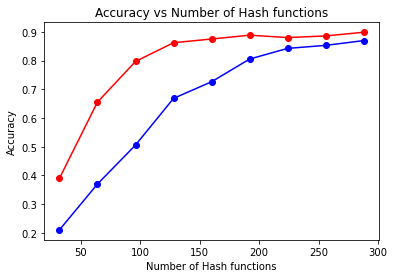

In [160]:
import matplotlib.pyplot as plt

y_values = [[0.21047619047619048, 0.37023809523809514, 0.5059523809523808, 0.6685714285714285, 0.7264285714285714, 0.8054761904761902, 0.8426190476190476, 0.853095238095238, 0.8697619047619046], [0.3899999999999999, 0.6554761904761907, 0.7971428571428574, 0.8623809523809524, 0.8752380952380954, 0.8885714285714286, 0.880238095238095, 0.8859523809523808, 0.8988095238095235]]
x_values = [i*32 for i in range(1, 10)]

plt.plot(x_values, y_values[0], 'bo-')
plt.plot(x_values, y_values[1], 'ro-')
plt.xlabel('Number of Hash functions')
plt.ylabel('Accuracy')
plt.title('Accuracy vs Number of Hash functions')

plt.show()